This is a notebook for running SHapley Additive exPlanations (SHAP), an explainable artificial intelligence technique, on our THOR NN ensemble. It is model agnostic and tells us which inputs were important for the NN in making its output prediction.

In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

from numba.core.errors import NumbaDeprecationWarning
import warnings
warnings.simplefilter('ignore', category=NumbaDeprecationWarning)

import shap
import numpy as np
import pylab as plt
from matplotlib.colors import ListedColormap
from mpl_toolkits.basemap import *
import matplotlib
import matplotlib.path as mpath
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from scipy.io import loadmat
from pickle import load

from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Reshape, Flatten, Input, Dropout, BatchNormalization, Concatenate
from tensorflow.keras.optimizers import Adam, SGD, RMSprop

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


In [2]:
col_height = xr.open_dataset(f'Data_Step2/control/col_height.nc').rename({'yh':'lat', 'xh':'lon'})['col_height']
# Ensure that longitude coords are from -180 to 180
col_height.coords['lon'] = (col_height.coords['lon'] + 180) % 360 - 180
col_height = col_height.sortby(col_height.lon)

In [3]:
scaler = load(open(f'Data_Step2/control/scaler.pkl', 'rb'))
scaler.mean_, scaler.scale_

(array([-2.85953411e-11,  3.68473248e+03, -2.93517822e-01, -1.78395655e-05,
         7.85527389e-05,  2.14230237e-03,  4.95123948e-07,  6.49555247e-07,
         3.01111445e+08, -1.45646523e+07]),
 array([1.86685043e-10, 1.61048766e+03, 7.99068436e-01, 1.03240757e-04,
        6.63678833e-01, 4.30530589e-02, 1.86624197e-05, 2.45397653e-06,
        1.35950753e+09, 9.36660921e+08]))

In [4]:
experiment = 'ssp585_2080_2099'
num_clusters = 6

missingdataindex = np.load(f'Data_Step2/{experiment}/missingdataindex.npy')
maskTraining = np.load(f'Data_Step2/{experiment}/maskTraining.npy')
maskVal = np.load(f'Data_Step2/{experiment}/maskVal.npy')
maskTest = np.load(f'Data_Step2/{experiment}/maskTest.npy')

# Retrive all the input features for a given experiment
total_features = np.load(f'Data_Step2/{experiment}/total_features.npy')
train_features = np.load(f'Data_Step2/{experiment}/train_features.npy')
val_features = np.load(f'Data_Step2/{experiment}/val_features.npy')
test_features = np.load(f'Data_Step2/{experiment}/test_features.npy')

X_total_scaled = scaler.transform(total_features)
X_train_scaled = scaler.transform(train_features)
X_val_scaled = scaler.transform(val_features)
X_test_scaled = scaler.transform(test_features)

X_train_scaled.shape

(481049, 10)

In [5]:
feature_names = ['curlTau', 'col_height', 'zos', 'f', 'gradColHeight_x', 'gradColHeight_y', 'gradZos_x', 'gradZos_y', 'umo_2d', 'vmo_2d']

In [6]:
# If loading from saved values
model_name = f'model_24x2_16x2_tanh_{num_clusters}_clusters'
total_pred = xr.open_dataset(f'Data_Step2/{experiment}/{model_name}_ensemble_mean_pred.nc')['Model Pred']
num_members = 50

shap_vals = np.load(f'shap_results/{model_name}/{experiment}/shap_vals_{num_members}.npy')
shap_base_vals = np.load(f'shap_results/{model_name}/{experiment}/shap_base_vals_{num_members}.npy')
shap_data = np.load(f'shap_results/{model_name}/{experiment}/shap_data_{num_members}.npy')

In [ ]:
# For running SHAP on a single model
model_name = f'model_24x2_16x2_tanh_{num_clusters}_clusters_epac_1'

model = tf.keras.models.load_model(f'saved_models/{model_name}.h5')

explainer = shap.Explainer(model, X_train_scaled, algorithm='exact', feature_names=feature_names)
shap_info = explainer(X_test_scaled)

shap_vals = shap_info.values
shap_base_vals = shap_info.base_values
shap_data = shap_info.data

#np.save(f'shap_results/shap_vals_{model_name}.npy', shap_vals)
#np.save(f'shap_results/shap_base_vals_{model_name}.npy', shap_base_vals)
#np.save(f'shap_results/shap_data_{model_name}.npy', shap_data)

In [ ]:
# For running SHAP on an ensemble of models
# NOTE: THIS TAKES A VERY LONG TIME TO RUN, CONSIDER USING shap_script.py
model_name = 'model_24x2_16x2_tanh_6_clusters_epac'

if not os.path.isdir(f'shap_results/{model_name}/'):
    os.makedirs(f'shap_results/{model_name}/')
    print('Model directory created')
else:
    print('Model directory already exists')

shap_info_list = []

for i in range(5):
    tf.keras.backend.clear_session()
    model = None
    
    model = tf.keras.models.load_model(f'saved_models/{model_name}/model_{i}.h5')
    
    explainer = None
    explainer = shap.Explainer(model, X_train_scaled, algorithm='exact', feature_names=feature_names)
    shap_info = explainer(X_test_scaled)
    shap_info_list.append(shap_info)
    
    if i % 5 == 4:
        shap_vals = np.array([shap_info_list[i].values for i in range(len(shap_info_list))])
        shap_base_vals = np.array([shap_info_list[i].base_values for i in range(len(shap_info_list))])
        shap_data = np.array([shap_info_list[i].data for i in range(len(shap_info_list))])
        
        np.save(f'shap_results/{model_name}/shap_vals_{i+1}.npy', shap_vals)
        np.save(f'shap_results/{model_name}/shap_base_vals_{i+1}.npy', shap_base_vals)
        np.save(f'shap_results/{model_name}/shap_data_{i+1}.npy', shap_data)

In [7]:
shap_vals.shape, shap_base_vals.shape, shap_data.shape

((50, 834418, 10, 6), (50, 834418, 6), (50, 834418, 10))

In [8]:
shap_base_mean = shap_base_vals.mean(axis=0)

diff = shap_base_vals - shap_base_mean

for i in range(10):
    shap_vals[:,:,i,:] = shap_vals[:,:,i,:] + diff

In [9]:
# Get various quantiles of the SHAP values
quantile_05 = np.quantile(shap_vals, 0.05, axis=0)
quantile_25 = np.quantile(shap_vals, 0.25, axis=0)
quantile_50 = np.quantile(shap_vals, 0.5, axis=0)
quantile_75 = np.quantile(shap_vals, 0.75, axis=0)
quantile_95 = np.quantile(shap_vals, 0.95, axis=0)

In [10]:
explainer_05 = shap._explanation.Explanation(quantile_05, base_values=shap_base_mean, data=shap_data, feature_names=feature_names)
explainer_25 = shap._explanation.Explanation(quantile_25, base_values=shap_base_mean, data=shap_data, feature_names=feature_names)
explainer_50 = shap._explanation.Explanation(quantile_50, base_values=shap_base_mean, data=shap_data, feature_names=feature_names)
explainer_75 = shap._explanation.Explanation(quantile_75, base_values=shap_base_mean, data=shap_data, feature_names=feature_names)
explainer_95 = shap._explanation.Explanation(quantile_95, base_values=shap_base_mean, data=shap_data, feature_names=feature_names)

In [11]:
def plot_shap_by_group(group_num, shap_values,):
    group_shap_vals = np.nan * np.zeros((1080,1440,10))
    group_shap_vals[~missingdataindex] = shap_values.values[:,:,group_num]
    group_shap_vals = xr.DataArray(data=group_shap_vals,
                                   dims=['lat','lon','cluster'],
                                   coords=dict(lat=col_height['lat'], lon=col_height['lon'], cluster=range(10)),
                                   name='Group SHAP values')
    
    fig, axes = plt.subplots(1, 11, subplot_kw={'projection':ccrs.Miller()}, figsize=(17.5,3.5), constrained_layout=True)
    
    group_pred = xr.where(total_pred == group_num, total_pred, np.nan)
    group_pred.isel(lon=slice(400,800)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                             cmap=ListedColormap(plt.get_cmap('tab20', num_clusters).colors[group_num]),
                                             add_colorbar=False)
    
    c_lim_max = np.percentile(shap_values.values[:,:,group_num], 95)
    c_lim_min = np.percentile(shap_values.values[:,:,group_num], 5)
    clim = max(abs(c_lim_max), abs(c_lim_min))
    c_lim_max = clim
    c_lim_min = -clim
    
    for i in range(1,11):
        input_var_shap = group_shap_vals.sel(cluster=i-1).isel(lon=slice(400,800))
        if i == 10:
            input_var_shap.plot(ax=axes[i], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=True,
                                vmin=c_lim_min, vmax=c_lim_max, cbar_kwargs={'label':''})
        else:
            input_var_shap.plot(ax=axes[i], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=False,
                                vmin=c_lim_min, vmax=c_lim_max)
        axes[i].set_title('')
    
    titles = ['Predicted regime'] + feature_names
    
    for i in range(11):
        axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[i].coastlines(resolution='10m')
        axes[i].set_title(titles[i])
        
    plt.show()
    
def plot_shap_by_group_socean(group_num, shap_values,):
    group_shap_vals = np.nan * np.zeros((1080,1440,10))
    group_shap_vals[~missingdataindex] = shap_values.values[:,:,group_num]
    group_shap_vals = xr.DataArray(data=group_shap_vals,
                                   dims=['lat','lon','cluster'],
                                   coords=dict(lat=col_height['lat'], lon=col_height['lon'], cluster=range(10)),
                                   name='Group SHAP values')
    
    fig, axes = plt.subplots(1, 11, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(24,2.5), constrained_layout=True)
    
    group_pred = xr.where(total_pred == group_num, total_pred, np.nan)
    group_pred.sel(lat=slice(-90,-40)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                             cmap=ListedColormap(plt.get_cmap('tab20', num_clusters).colors[group_num]),
                                             add_colorbar=False)
    
    c_lim_max = np.percentile(shap_values.values[:,:,group_num], 95)
    c_lim_min = np.percentile(shap_values.values[:,:,group_num], 5)
    clim = max(abs(c_lim_max), abs(c_lim_min))
    c_lim_max = clim
    c_lim_min = -clim
    
    for i in range(1,11):
        input_var_shap = group_shap_vals.sel(cluster=i-1).sel(lat=slice(-90,-40))
        if i == 10:
            input_var_shap.plot(ax=axes[i], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=True,
                                vmin=c_lim_min, vmax=c_lim_max, cbar_kwargs={'label':''})
        else:
            input_var_shap.plot(ax=axes[i], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=False,
                                vmin=c_lim_min, vmax=c_lim_max)
        axes[i].set_title('')
    
    titles = ['Predicted regime'] + feature_names
    
    # Compute a circle in axes coordinates, which we can use as a boundary
    # for the map. We can pan/zoom as much as we like - the boundary will be
    # permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    
    for i in range(11):
        axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[i].coastlines(resolution='10m')
        axes[i].set_title(titles[i])
        axes[i].set_boundary(circle, transform=axes[i].transAxes)
        
    plt.show()

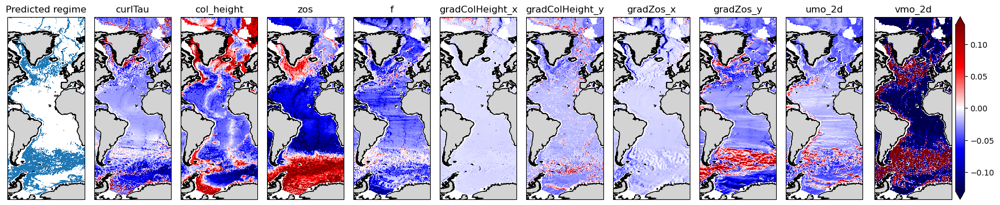

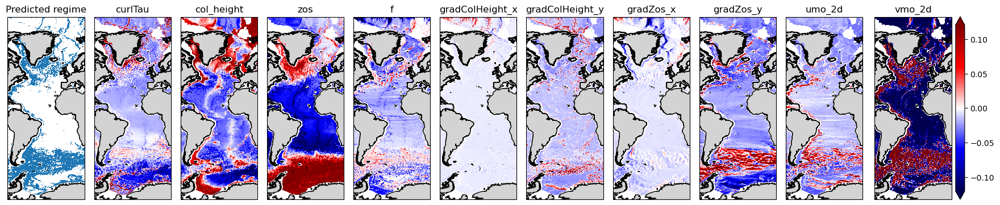

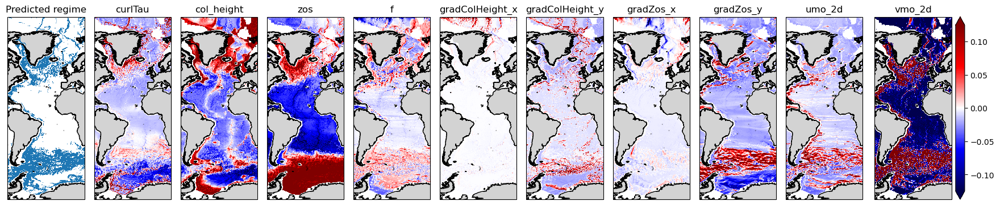

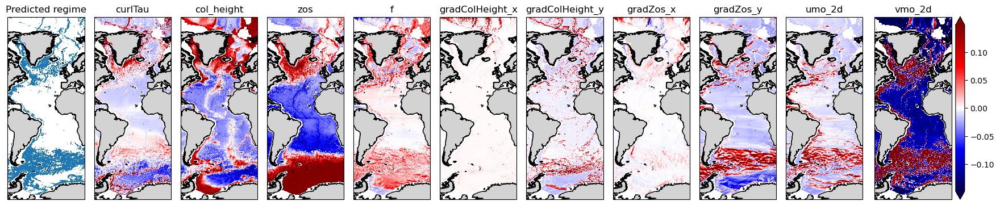

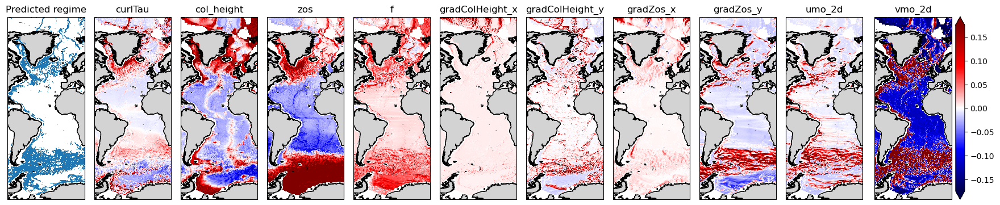

In [12]:
plot_shap_by_group(0, explainer_05)
plot_shap_by_group(0, explainer_25)
plot_shap_by_group(0, explainer_50)
plot_shap_by_group(0, explainer_75)
plot_shap_by_group(0, explainer_95)

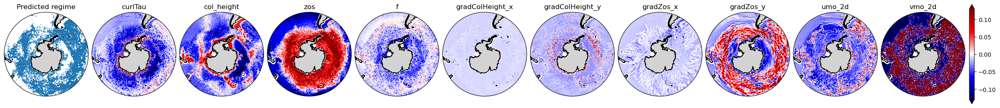

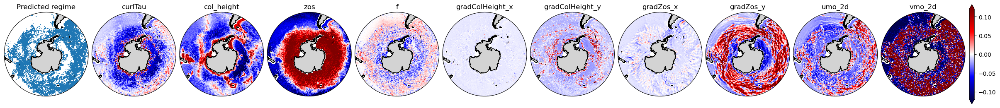

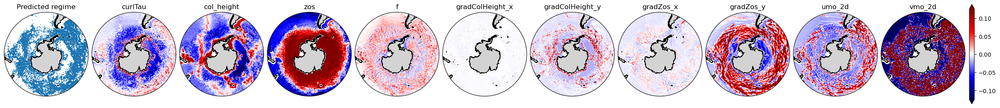

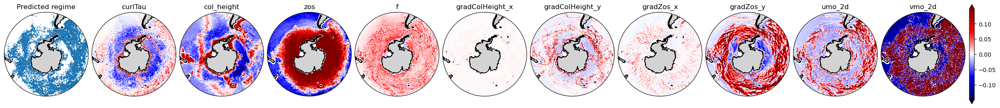

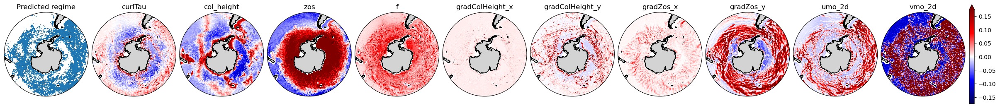

In [13]:
plot_shap_by_group_socean(0, explainer_05)
plot_shap_by_group_socean(0, explainer_25)
plot_shap_by_group_socean(0, explainer_50)
plot_shap_by_group_socean(0, explainer_75)
plot_shap_by_group_socean(0, explainer_95)

In [12]:
# Get only the SHAP values which are consistent between the 25th and 75th percentile
shap_consist = np.zeros(quantile_25.shape)
shap_consist[quantile_75 < 0] = quantile_75[quantile_75 < 0]
shap_consist[quantile_25 > 0] = quantile_25[quantile_25 > 0]
explainer_consist = shap._explanation.Explanation(shap_consist, base_values=shap_base_mean,
                                                  data=shap_data, feature_names=feature_names)

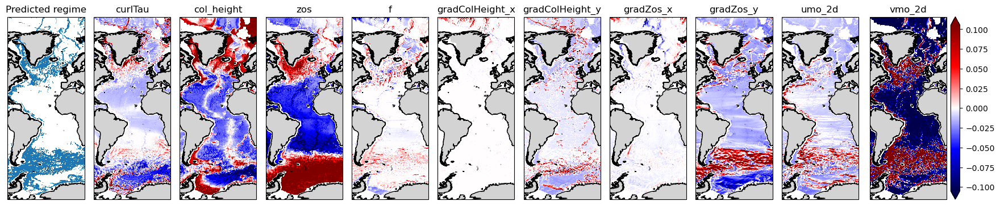

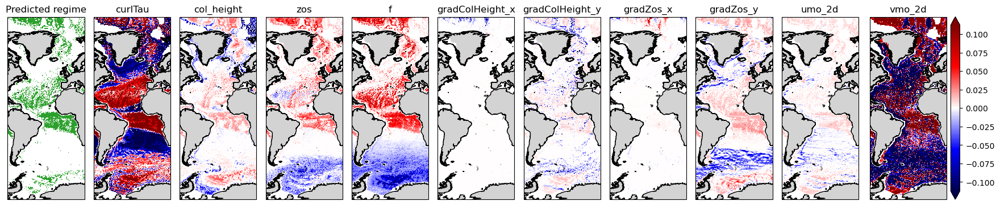

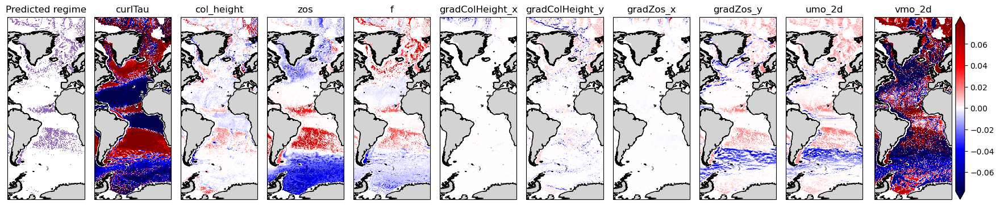

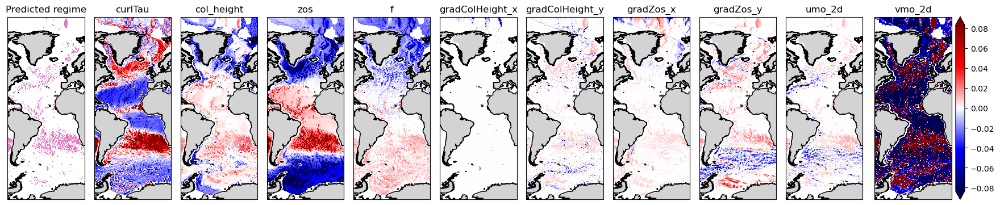

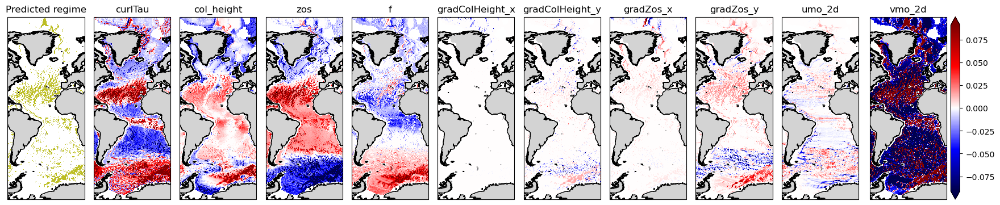

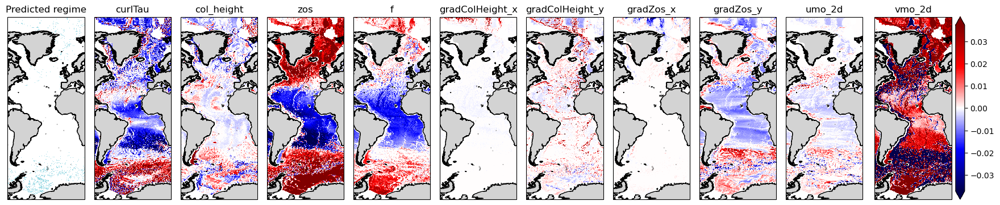

In [15]:
plot_shap_by_group(0, explainer_consist)
plot_shap_by_group(1, explainer_consist)
plot_shap_by_group(2, explainer_consist)
plot_shap_by_group(3, explainer_consist)
plot_shap_by_group(4, explainer_consist)
plot_shap_by_group(5, explainer_consist)

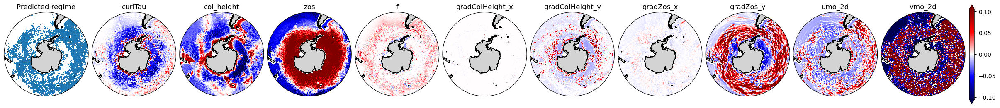

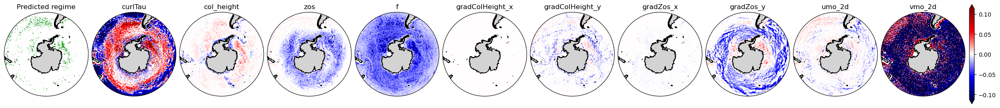

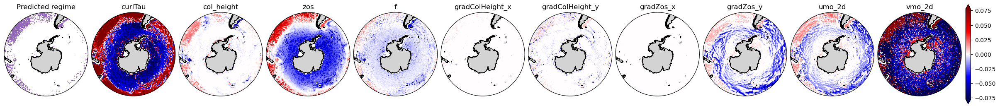

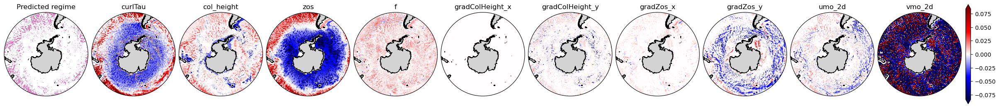

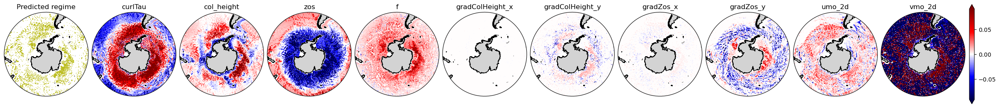

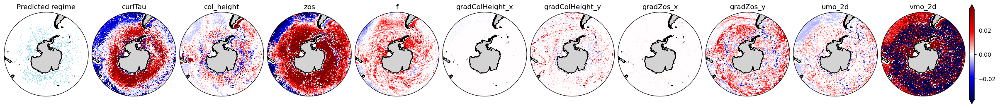

In [16]:
plot_shap_by_group_socean(0, explainer_consist)
plot_shap_by_group_socean(1, explainer_consist)
plot_shap_by_group_socean(2, explainer_consist)
plot_shap_by_group_socean(3, explainer_consist)
plot_shap_by_group_socean(4, explainer_consist)
plot_shap_by_group_socean(5, explainer_consist)

In [13]:
def plot_shap_by_group_socean_single_fig(shap_values, save_path=None):
    fig, axes = plt.subplots(11, num_clusters, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,24), constrained_layout=True)

    for group_num in range(num_clusters):
        group_shap_vals = np.nan * np.zeros((1080,1440,10))
        group_shap_vals[~missingdataindex] = shap_values.values[:,:,group_num]
        group_shap_vals = xr.DataArray(data=group_shap_vals,
                                       dims=['lat','lon','cluster'],
                                       coords=dict(lat=col_height['lat'], lon=col_height['lon'], cluster=range(10)),
                                       name='Group SHAP values')
        
        group_pred = xr.where(total_pred == group_num, total_pred, np.nan)
        group_pred.sel(lat=slice(-90,-40)).plot(ax=axes[0,group_num], transform=ccrs.PlateCarree(),
                                                 cmap=ListedColormap(plt.get_cmap('tab20', num_clusters).colors[group_num]),
                                                 add_colorbar=False)
    
        c_lim_max = np.percentile(shap_values.values[:,:,group_num], 95)
        c_lim_min = np.percentile(shap_values.values[:,:,group_num], 5)
        clim = max(abs(c_lim_max), abs(c_lim_min))
        c_lim_max = clim
        c_lim_min = -clim
    
        for i in range(1,11):
            input_var_shap = group_shap_vals.sel(cluster=i-1).sel(lat=slice(-90,-40))
            if i == 10:
                input_var_shap.plot(ax=axes[i,group_num], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=True,
                                    vmin=-0.1, vmax=0.1, cbar_kwargs={'label':'', 'orientation':'horizontal'})
            else:
                input_var_shap.plot(ax=axes[i,group_num], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=False,
                                    vmin=-0.1, vmax=0.1)
            axes[i,group_num].set_title('')
    
    ylabs = ['Expanse'] + feature_names
    
    # Compute a circle in axes coordinates, which we can use as a boundary
    # for the map. We can pan/zoom as much as we like - the boundary will be
    # permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    
    for i in range(11):
        for j in range(num_clusters):
            if i == 0:
                axes[i,j].set_title(f'Regime {j}')
            axes[i,j].set_yticks([])
            if j != 0:
                axes[i,j].set_ylabel('')
            else:
                axes[i,j].set_ylabel(ylabs[i])
            axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
            axes[i,j].coastlines(resolution='10m')
            axes[i,j].set_boundary(circle, transform=axes[i,j].transAxes)
    
    if save_path != None:
        plt.savefig(save_path, dpi=600)
    plt.show()

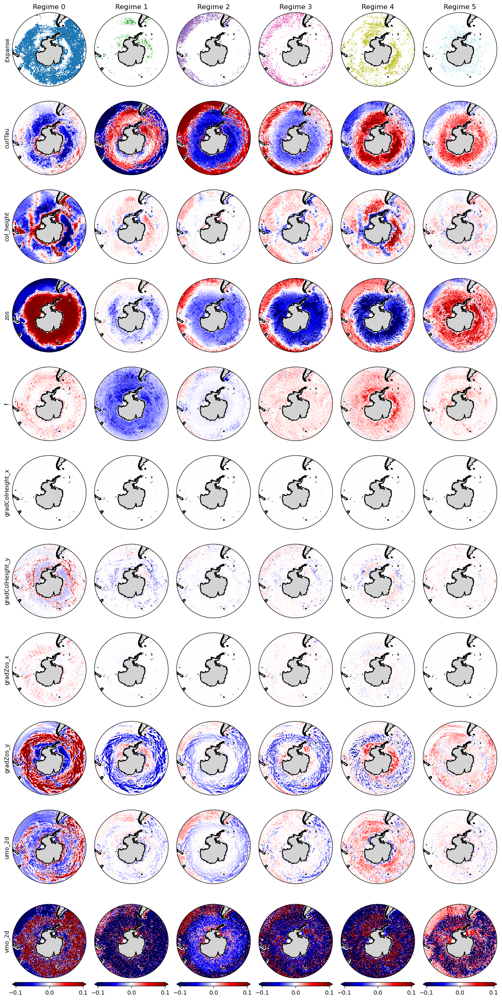

In [14]:
plot_shap_by_group_socean_single_fig(explainer_consist, save_path=f'figures/shap/shap_by_regime_socean_{experiment}.png')

In [15]:
def plot_shap_by_group_socean_first_half(shap_values, save_path=None):
    fig, axes = plt.subplots(6, num_clusters, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,12), constrained_layout=True)

    for group_num in range(num_clusters):
        group_shap_vals = np.nan * np.zeros((1080,1440,10))
        group_shap_vals[~missingdataindex] = shap_values.values[:,:,group_num]
        group_shap_vals = xr.DataArray(data=group_shap_vals,
                                       dims=['lat','lon','cluster'],
                                       coords=dict(lat=col_height['lat'], lon=col_height['lon'], cluster=range(10)),
                                       name='Group SHAP values')
        
        group_pred = xr.where(total_pred == group_num, total_pred, np.nan)
        group_pred.sel(lat=slice(-90,-40)).plot(ax=axes[0,group_num], transform=ccrs.PlateCarree(),
                                                 cmap=ListedColormap(plt.get_cmap('tab20', num_clusters).colors[group_num]),
                                                 add_colorbar=False)
    
        c_lim_max = np.percentile(shap_values.values[:,:,group_num], 95)
        c_lim_min = np.percentile(shap_values.values[:,:,group_num], 5)
        clim = max(abs(c_lim_max), abs(c_lim_min))
        c_lim_max = clim
        c_lim_min = -clim
    
        for i in range(1,6):
            input_var_shap = group_shap_vals.sel(cluster=i-1).sel(lat=slice(-90,-40))
            if i == 5:
                input_var_shap.plot(ax=axes[i,group_num], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=True,
                                    vmin=-0.1, vmax=0.1, cbar_kwargs={'label':'', 'orientation':'horizontal'})
            else:
                input_var_shap.plot(ax=axes[i,group_num], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=False,
                                    vmin=-0.1, vmax=0.1)
            axes[i,group_num].set_title('')
    
    ylabs = ['Expanse'] + feature_names
    
    # Compute a circle in axes coordinates, which we can use as a boundary
    # for the map. We can pan/zoom as much as we like - the boundary will be
    # permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    
    for i in range(6):
        for j in range(num_clusters):
            if i == 0:
                axes[i,j].set_title(f'Regime {j}')
            axes[i,j].set_yticks([])
            if j != 0:
                axes[i,j].set_ylabel('')
            else:
                axes[i,j].set_ylabel(ylabs[i])
            axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
            axes[i,j].coastlines(resolution='10m')
            axes[i,j].set_boundary(circle, transform=axes[i,j].transAxes)
    
    if save_path != None:
        plt.savefig(save_path, dpi=600)
    plt.show()
    
def plot_shap_by_group_socean_second_half(shap_values, save_path=None):
    fig, axes = plt.subplots(6, num_clusters, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,12), constrained_layout=True)

    for group_num in range(num_clusters):
        group_shap_vals = np.nan * np.zeros((1080,1440,10))
        group_shap_vals[~missingdataindex] = shap_values.values[:,:,group_num]
        group_shap_vals = xr.DataArray(data=group_shap_vals,
                                       dims=['lat','lon','cluster'],
                                       coords=dict(lat=col_height['lat'], lon=col_height['lon'], cluster=range(10)),
                                       name='Group SHAP values')
        
        group_pred = xr.where(total_pred == group_num, total_pred, np.nan)
        group_pred.sel(lat=slice(-90,-40)).plot(ax=axes[0,group_num], transform=ccrs.PlateCarree(),
                                                 cmap=ListedColormap(plt.get_cmap('tab20', num_clusters).colors[group_num]),
                                                 add_colorbar=False)
    
        c_lim_max = np.percentile(shap_values.values[:,:,group_num], 95)
        c_lim_min = np.percentile(shap_values.values[:,:,group_num], 5)
        clim = max(abs(c_lim_max), abs(c_lim_min))
        c_lim_max = clim
        c_lim_min = -clim
    
        for i in range(1,6):
            input_var_shap = group_shap_vals.sel(cluster=i+5-1).sel(lat=slice(-90,-40))
            if i == 5:
                input_var_shap.plot(ax=axes[i,group_num], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=True,
                                    vmin=-0.1, vmax=0.1, cbar_kwargs={'label':'', 'orientation':'horizontal'})
            else:
                input_var_shap.plot(ax=axes[i,group_num], transform=ccrs.PlateCarree(), cmap='seismic', add_colorbar=False,
                                    vmin=-0.1, vmax=0.1)
            axes[i,group_num].set_title('')
    
    ylabs = ['Expanse'] + feature_names
    
    # Compute a circle in axes coordinates, which we can use as a boundary
    # for the map. We can pan/zoom as much as we like - the boundary will be
    # permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    
    for i in range(6):
        for j in range(num_clusters):
            if i == 0:
                axes[i,j].set_title(f'Regime {j}')
            axes[i,j].set_yticks([])
            if j != 0:
                axes[i,j].set_ylabel('')
            else:
                axes[i,j].set_ylabel(ylabs[i])
            axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
            axes[i,j].coastlines(resolution='10m')
            axes[i,j].set_boundary(circle, transform=axes[i,j].transAxes)
    
    if save_path != None:
        plt.savefig(save_path, dpi=600)
    plt.show()

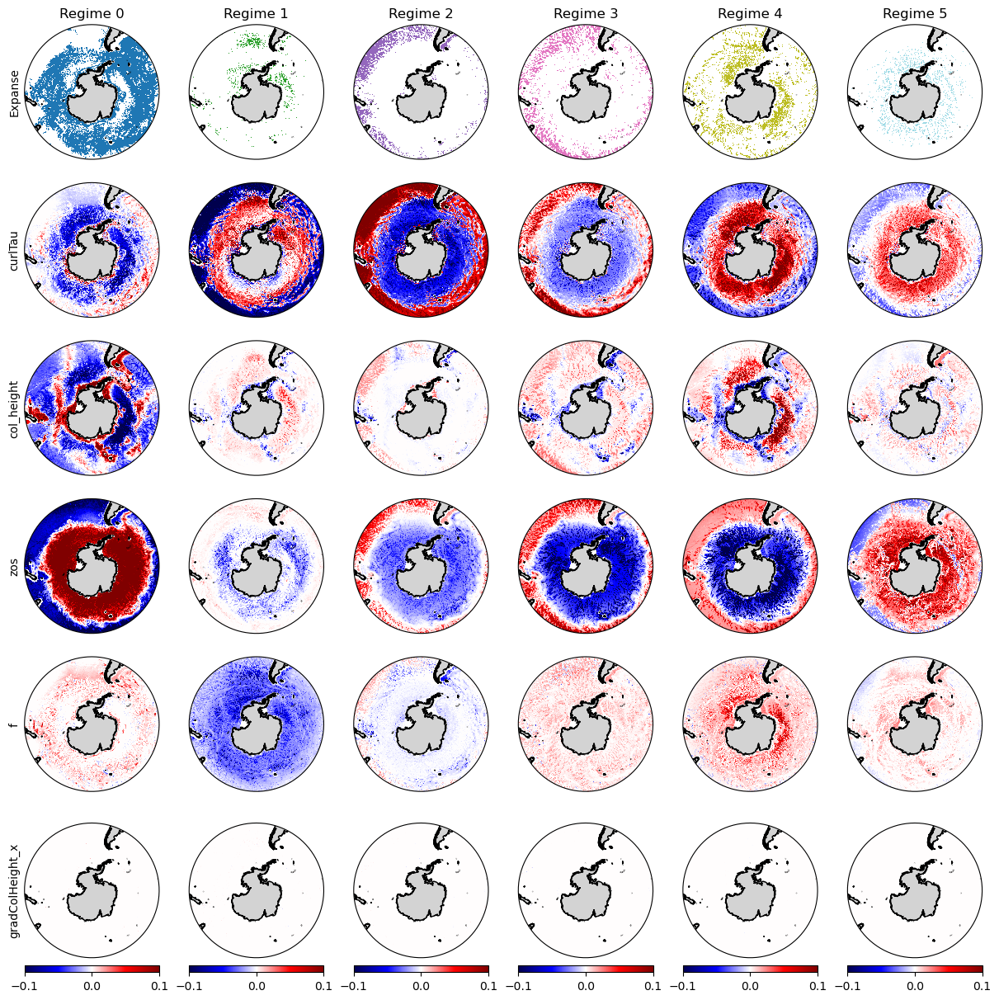

In [16]:
feature_names = ['curlTau', 'col_height', 'zos', 'f', 'gradColHeight_x']

plot_shap_by_group_socean_first_half(
    explainer_consist, save_path=f'figures/neurips/shap_by_regime_socean_{experiment}_first_half.png')

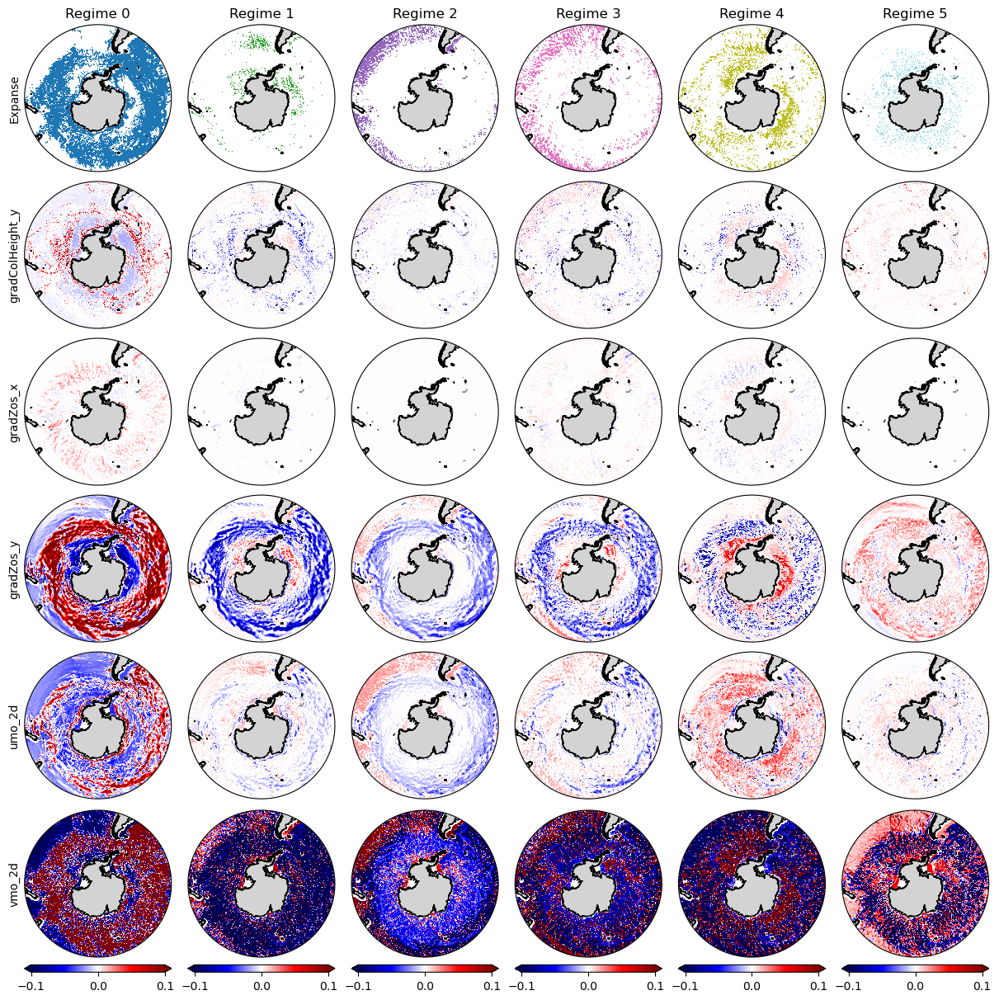

In [17]:
feature_names = ['gradColHeight_y', 'gradZos_x', 'gradZos_y', 'umo_2d', 'vmo_2d']

plot_shap_by_group_socean_second_half(
    explainer_consist, save_path=f'figures/neurips/shap_by_regime_socean_{experiment}_second_half.png')